In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import folium
from folium import plugins
import os

# Func to print message, accepts string
def display(message):
  print('__________________________', message,'__________________________\n')

# Using multiple files, get all paths and load into pandas
# get all files into a path_array
filepaths = [f for f in os.listdir("datasets") if f.endswith('.csv')]
path_ = []
count = 0
for file in filepaths:
  df = pd.read_csv('./datasets//'+file, index_col=None ,header=0, na_values='NaN', keep_default_na=False)
  count = count+(len(df))
  path_.append(df)

display('Summary of data sets')
crimeData = pd.concat(path_,axis=0)
crimeData.info()

print('\nLength of data -----> ',len(crimeData))


__________________________ Summary of data sets __________________________

<class 'pandas.core.frame.DataFrame'>
Int64Index: 600634 entries, 0 to 5506
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   Crime ID               600634 non-null  object
 1   Month                  600634 non-null  object
 2   Reported by            600634 non-null  object
 3   Falls within           600634 non-null  object
 4   Longitude              600634 non-null  object
 5   Latitude               600634 non-null  object
 6   Location               600634 non-null  object
 7   LSOA code              600634 non-null  object
 8   LSOA name              600634 non-null  object
 9   Crime type             600634 non-null  object
 10  Last outcome category  600634 non-null  object
 11  Context                600634 non-null  object
dtypes: object(12)
memory usage: 59.6+ MB

Length of data ----->  600634


In [2]:
# Clean Data, remove nulls, duplicates and NaNs
crimeData.isna().sum()
crimeData.duplicated(subset=None, keep='first').count()
crimeData.drop_duplicates()
crimeData = crimeData.iloc[:,[0,1,2,3,4,5,6,7,8,9,10,11]]

crimeData.dropna(inplace=True)

crimeData['Latitude'] = pd.to_numeric(crimeData['Latitude'], downcast='float')
crimeData['Longitude'] = pd.to_numeric(crimeData['Longitude'], downcast='float')

crimeData.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 600634 entries, 0 to 5506
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Crime ID               600634 non-null  object 
 1   Month                  600634 non-null  object 
 2   Reported by            600634 non-null  object 
 3   Falls within           600634 non-null  object 
 4   Longitude              591871 non-null  float32
 5   Latitude               591871 non-null  float32
 6   Location               600634 non-null  object 
 7   LSOA code              600634 non-null  object 
 8   LSOA name              600634 non-null  object 
 9   Crime type             600634 non-null  object 
 10  Last outcome category  600634 non-null  object 
 11  Context                600634 non-null  object 
dtypes: float32(2), object(10)
memory usage: 55.0+ MB


__________________________ REPORTING DATA __________________________



Text(0.5, 1.0, 'Crime Spread between 2019-2021 North&South Wales')

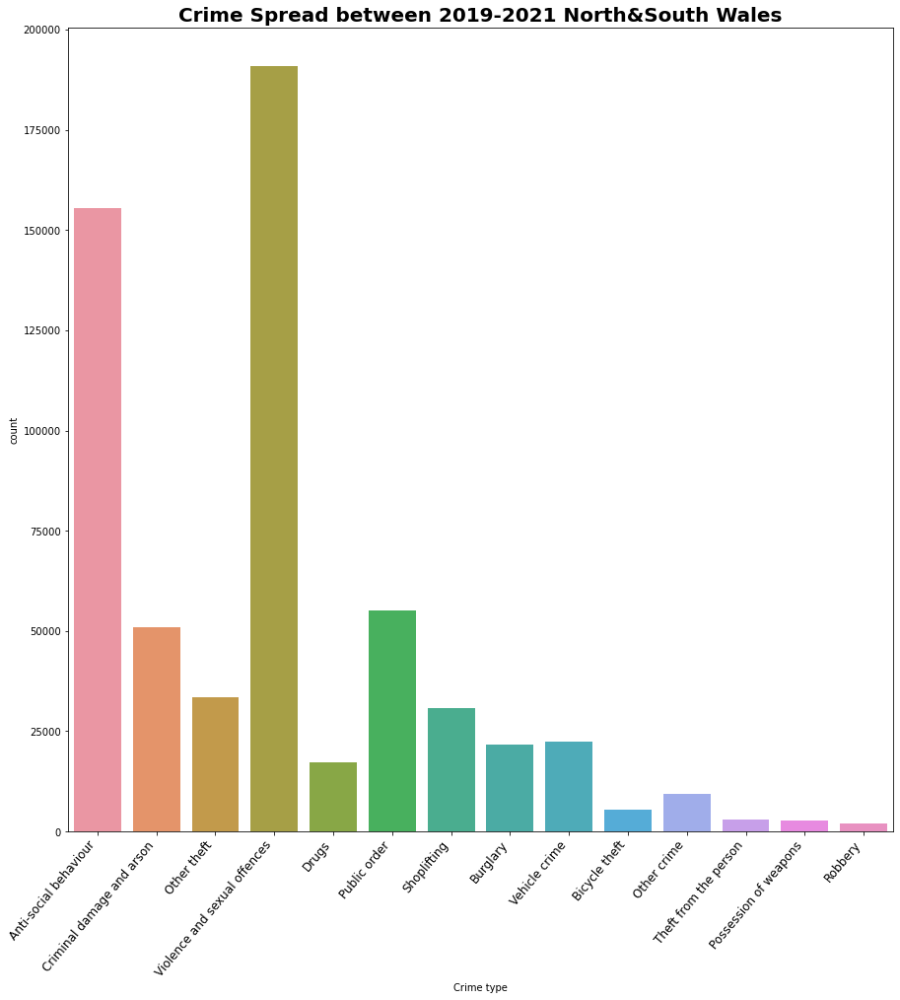

In [3]:
display('REPORTING DATA')
# Total Distribution of crime type spread over 3 years(2019-2021) in North and South Wales combined.
plt.figure(figsize=(15, 15))

sns.countplot(x="Crime type",data=crimeData)
plt.xticks(
  horizontalalignment='right',
  rotation=50,
  fontsize='large',
  fontweight='light',
)
plt.title('Crime Spread between 2019-2021 North&South Wales', font=dict(size=20, weight='bold'))

__________________________ Overview of Crime Data in North Wales __________________________

__________________________ January 2019 - September 2021 __________________________



<ipython-input-4-46ba91cd7b88>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  northData['Month'] = pd.to_datetime(northData['Month'])
<ipython-input-4-46ba91cd7b88>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  northData['Year'] = northData['Month'].apply(lambda x : x.year)
<ipython-input-4-46ba91cd7b88>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://p

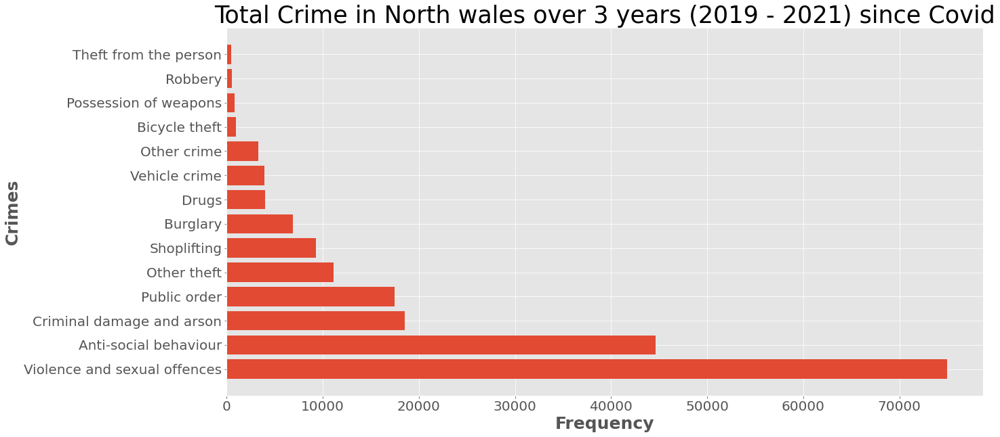

In [4]:
# NORTH DATA FILTERED
display('Overview of Crime Data in North Wales')
display('January 2019 - September 2021')

crimeRegion = crimeData.groupby('Falls within')
crimeRegion.groups.keys()

northData = crimeRegion.get_group('North Wales Police')
northData['Month'] = pd.to_datetime(northData['Month'])
northData['Year'] = northData['Month'].apply(lambda x : x.year)
northData['Count'] = northData.groupby('Crime type')['Crime type'].transform('count')

# North Wales Data Overview
countNorthData = dict(northData["Crime type"].value_counts())
x = list(countNorthData.keys())
y = list(countNorthData.values())

plt.figure(figsize=(20, 10))
plt.style.use('ggplot')
plt.barh(x, y)
plt.title('Total Crime in North wales over 3 years (2019 - 2021) since Covid', fontweight='bold', font=dict(size=35))
plt.ylabel('Crimes', fontweight='bold', size=25)
plt.xlabel('Frequency', fontweight='bold', size=25)
plt.xticks(size = 20)
plt.yticks(size = 20)
plt.show()


__________________________ Statistical Distribution of North Wales Crime data 2019-2021 __________________________



<Figure size 2160x1440 with 0 Axes>

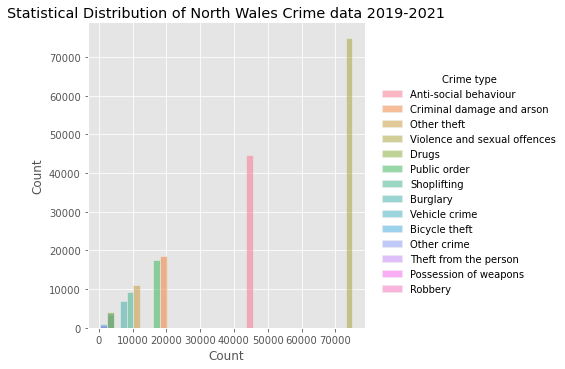

In [5]:
display('Statistical Distribution of North Wales Crime data 2019-2021')
plt.figure(figsize=(30, 20))
sns.displot(northData, x='Count', hue='Crime type').set(title='Statistical Distribution of North Wales Crime data 2019-2021')


__________________________ North wales 2019 Crime Data __________________________



Text(0.5, 1.0, 'Total Crime distribution in Northwales for 2019')

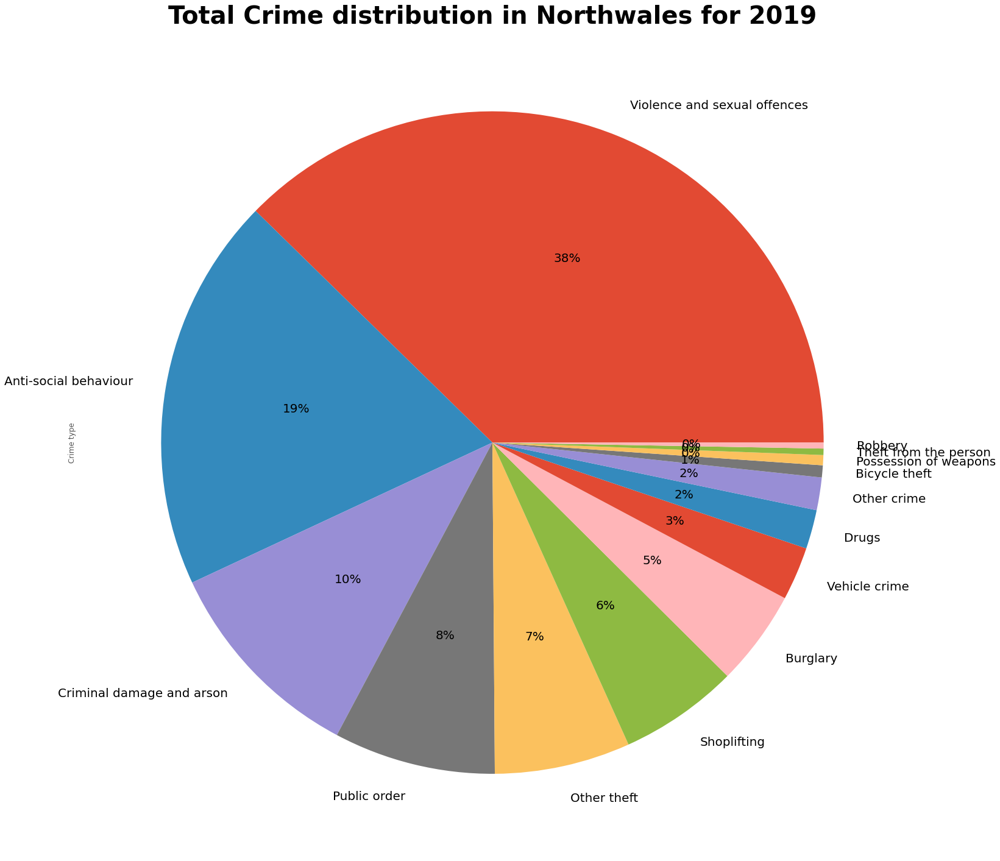

In [6]:
# Yearly Overview North Wales crime data
display('North wales 2019 Crime Data')
nwYear = northData.groupby('Year')
nw2019 =nwYear.get_group(2019)
nw2019['Crime type'].value_counts().plot(
  kind='pie',
  figsize=(25,25),
  fontsize=20,
  autopct='%1.0f%%'
)
plt.style.use('bmh')
plt.title('Total Crime distribution in Northwales for 2019', font=dict(size=40, weight='bold'))

__________________________ North wales 2020 Crime Data __________________________



Text(0.5, 1.0, 'Total Crime distribution in Northwales for 2020')

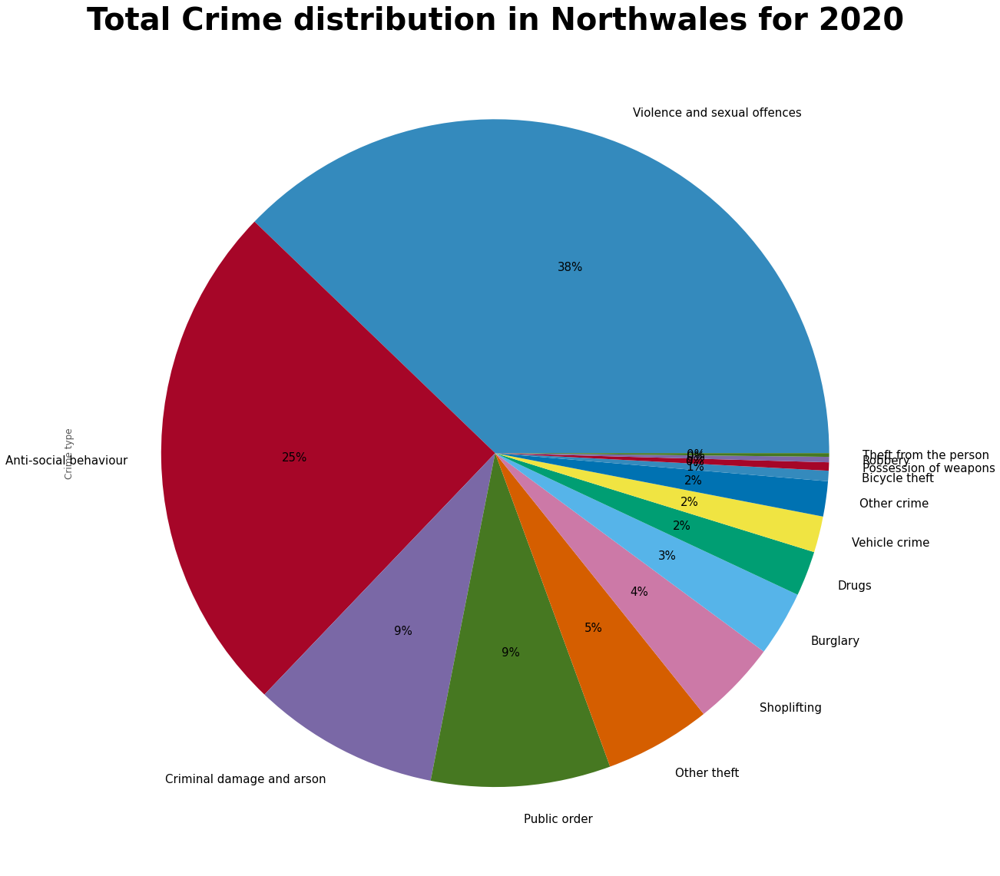

In [7]:
display('North wales 2020 Crime Data')
nwYear = northData.groupby('Year')
nw2020 =nwYear.get_group(2020)
nw2020['Crime type'].value_counts().plot(
  kind='pie',
  figsize=(20,20),
  fontsize=15,
  autopct='%1.0f%%'
)
plt.style.use('ggplot')
plt.title('Total Crime distribution in Northwales for 2020', font=dict(size=40, weight='bold'))

__________________________ North wales 2021 Crime Data __________________________



Text(0.5, 1.0, 'Total Crime distribution in Northwales for 2021')

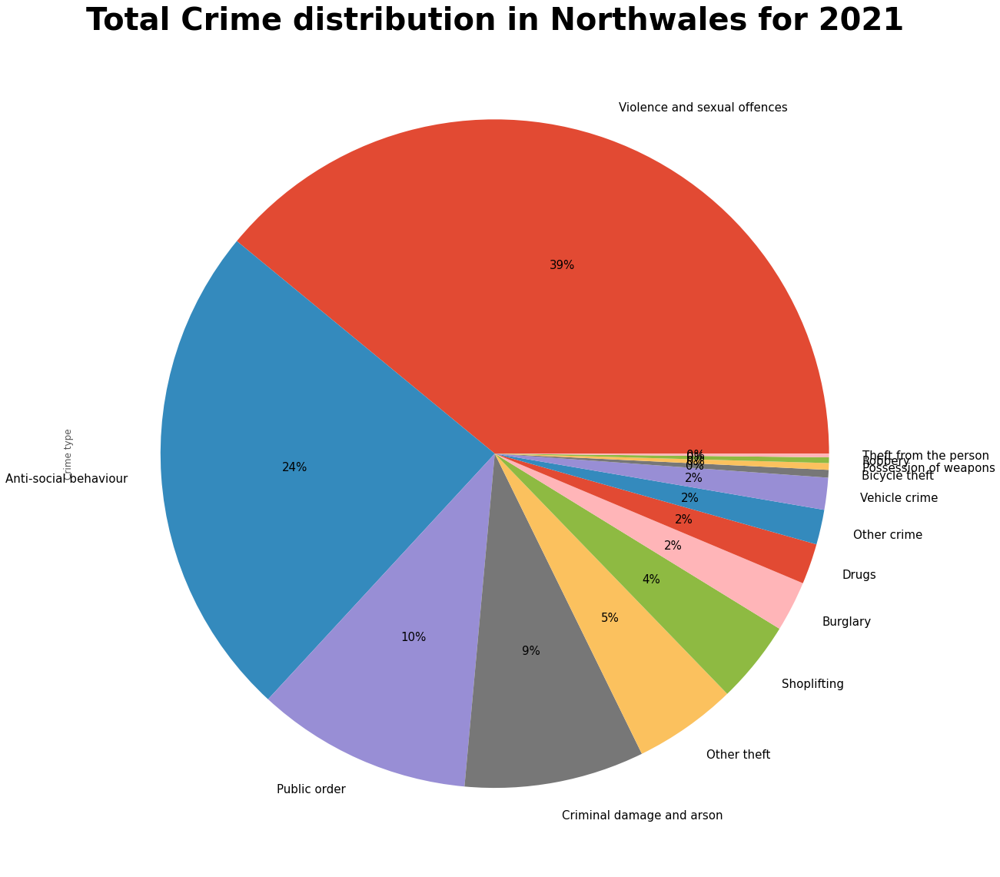

In [8]:
display('North wales 2021 Crime Data')
nwYear = northData.groupby('Year')
nw2021 =nwYear.get_group(2021)
nw2021['Crime type'].value_counts().plot(
  kind='pie',
  figsize=(20,20),
  fontsize=15,
  autopct='%1.0f%%'
)
plt.style.use('ggplot')
plt.title('Total Crime distribution in Northwales for 2021', font=dict(size=40, weight='bold'))


__________________________ North Wales Crime Data compared 2019 - 2021 by Month __________________________



Text(0.5, 1.0, 'North Wales Crime Data compared 2019 - 2021 by Month')

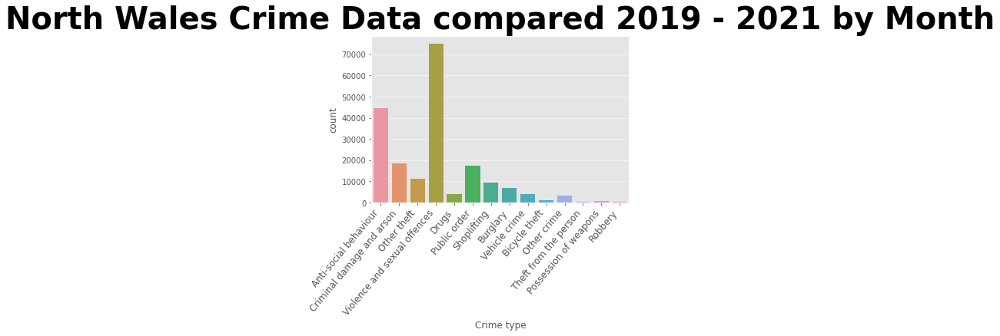

In [9]:
display('North Wales Crime Data compared 2019 - 2021 by Month')
northData.groupby('Year')
sns.countplot(x="Crime type",data=northData)
plt.xticks(
  horizontalalignment='right',
  rotation=50,
  fontsize='large',
  fontweight='light',
)
plt.title('North Wales Crime Data compared 2019 - 2021 by Month', font=dict(size=40, weight='bold'))


In [10]:
# SOUTH DATA Filtered
display('Overview of Crime Data in South Wales')
display('January 2019 - September 2021')

southData = crimeRegion.get_group('South Wales Police')
southData['Month'] = pd.to_datetime(southData['Month'])
southData['Year'] = southData['Month'].apply(lambda x : x.year)
southData['Count'] = southData.groupby('Crime type')['Crime type'].transform('count')

swYear = southData.groupby('Year')
# line start
countSouthData = dict(southData["Crime type"].value_counts())

sx = list(countSouthData.keys())
sy = list(countSouthData.values())

plt.figure(figsize=(20, 10))
plt.style.use('ggplot')
swPx = px.line(southData, x=sx, y=sy, title='Total Crime in South Wales over 3 years since Covid')
swPx.show()


__________________________ Overview of Crime Data in South Wales __________________________

__________________________ January 2019 - September 2021 __________________________



<ipython-input-10-a365b59136c9>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  southData['Month'] = pd.to_datetime(southData['Month'])
<ipython-input-10-a365b59136c9>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  southData['Year'] = southData['Month'].apply(lambda x : x.year)
<ipython-input-10-a365b59136c9>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://

<Figure size 1440x720 with 0 Axes>

In [11]:
display('South wales 2021 Crime Data')

sw2021 = swYear.get_group(2021)
plt.figure(figsize=[40, 30])
fig = px.pie(sw2021, values='Count', names='Crime type', title='Total Crime distribution in South Wales for 2021')
fig.show()


__________________________ South wales 2021 Crime Data __________________________



<Figure size 2880x2160 with 0 Axes>

In [12]:
display('South Wales 2020 Crime Data')

sw2020 = swYear.get_group(2020)
plt.figure(figsize=[40, 30])
fig = px.pie(sw2020, values='Count', names='Crime type', title='Total Crime distribution in South Wales for 2020')
fig.show()


__________________________ South Wales 2020 Crime Data __________________________



<Figure size 2880x2160 with 0 Axes>

In [13]:
display('South Wales 2019 Crime Data')

sw2019 = swYear.get_group(2019)
plt.figure(figsize=[40, 30])
fig = px.pie(sw2019, values='Count', names='Crime type', title='Total Crime distribution in South Wales for 2019')
fig.show()


__________________________ South Wales 2019 Crime Data __________________________



<Figure size 2880x2160 with 0 Axes>

In [14]:
crime_area = list(zip(crimeData.Latitude, crimeData.Longitude))
def generateBaseMap(default_location=[52.1307, -3.7837], default_zoom_start=8):
  base_map = folium.Map(location=default_location, control_scale=True,zoom_start=default_zoom_start)
  heatmap = plugins.HeatMap(crime_area, radius=10, blur=3)
  base_map.add_child(heatmap)
  return base_map

generateBaseMap()


ValueError: Location values cannot contain NaNs.